# 你的第一个神经网络

在此项目中，你将构建你的第一个神经网络，并用该网络预测每日自行车租客人数。我们提供了一些代码，但是需要你来实现神经网络（大部分内容）。提交此项目后，欢迎进一步探索该数据和模型。

In [1]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

## 加载和准备数据

构建神经网络的关键一步是正确地准备数据。不同尺度级别的变量使网络难以高效地掌握正确的权重。我们在下方已经提供了加载和准备数据的代码。你很快将进一步学习这些代码！

In [2]:
data_path = 'Bike-Sharing-Dataset/hour.csv'

rides = pd.read_csv(data_path)

In [3]:
rides.head()

,instant,dteday,season,yr,mnth,hr,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt
0,1,2011-01-01,1,0,1,0,0,6,0,1,0.24,0.2879,0.81,0.0,3,13,16
1,2,2011-01-01,1,0,1,1,0,6,0,1,0.22,0.2727,0.80,0.0,8,32,40
2,3,2011-01-01,1,0,1,2,0,6,0,1,0.22,0.2727,0.80,0.0,5,27,32
3,4,2011-01-01,1,0,1,3,0,6,0,1,0.24,0.2879,0.75,0.0,3,10,13
4,5,2011-01-01,1,0,1,4,0,6,0,1,0.24,0.2879,0.75,0.0,0,1,1


## 数据简介

此数据集包含的是从 2011 年 1 月 1 日到 2012 年 12 月 31 日期间每天每小时的骑车人数。骑车用户分成临时用户和注册用户，cnt 列是骑车用户数汇总列。你可以在上方看到前几行数据。

下图展示的是数据集中前 10 天左右的骑车人数（某些天不一定是 24 个条目，所以不是精确的 10 天）。你可以在这里看到每小时租金。这些数据很复杂！周末的骑行人数少些，工作日上下班期间是骑行高峰期。我们还可以从上方的数据中看到温度、湿度和风速信息，所有这些信息都会影响骑行人数。你需要用你的模型展示所有这些数据。

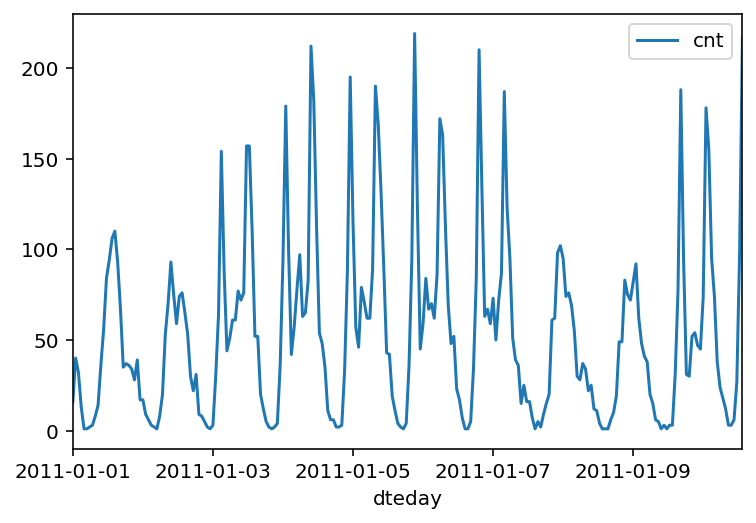

In [4]:
rides[:24*10].plot(x='dteday', y='cnt')

### 虚拟变量（哑变量）

下面是一些分类变量，例如季节、天气、月份。要在我们的模型中包含这些数据，我们需要创建二进制虚拟变量。用 Pandas 库中的 `get_dummies()` 就可以轻松实现。

In [5]:
dummy_fields = ['season', 'weathersit', 'mnth', 'hr', 'weekday']
for each in dummy_fields:
    dummies = pd.get_dummies(rides[each], prefix=each, drop_first=False)
    rides = pd.concat([rides, dummies], axis=1)

fields_to_drop = ['instant', 'dteday', 'season', 'weathersit', 
                  'weekday', 'atemp', 'mnth', 'workingday', 'hr']
data = rides.drop(fields_to_drop, axis=1)
data.head()

,yr,holiday,temp,hum,windspeed,casual,registered,cnt,season_1,season_2,...,hr_21,hr_22,hr_23,weekday_0,weekday_1,weekday_2,weekday_3,weekday_4,weekday_5,weekday_6
0,0,0,0.24,0.81,0.0,3,13,16,1,0,...,0,0,0,0,0,0,0,0,0,1
1,0,0,0.22,0.80,0.0,8,32,40,1,0,...,0,0,0,0,0,0,0,0,0,1
2,0,0,0.22,0.80,0.0,5,27,32,1,0,...,0,0,0,0,0,0,0,0,0,1
3,0,0,0.24,0.75,0.0,3,10,13,1,0,...,0,0,0,0,0,0,0,0,0,1
4,0,0,0.24,0.75,0.0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,1


### 调整目标变量

为了更轻松地训练网络，我们将对每个连续变量标准化，即转换和调整变量，使它们的均值为 0，标准差为 1。

我们会保存换算因子，以便当我们使用网络进行预测时可以还原数据。

In [6]:
quant_features = ['casual', 'registered', 'cnt', 'temp', 'hum', 'windspeed']
# Store scalings in a dictionary so we can convert back later
scaled_features = {}
for each in quant_features:
    mean, std = data[each].mean(), data[each].std()
    scaled_features[each] = [mean, std]
    data.loc[:, each] = (data[each] - mean)/std

### 将数据拆分为训练、测试和验证数据集

我们将大约最后 21 天的数据保存为测试数据集，这些数据集会在训练完网络后使用。我们将使用该数据集进行预测，并与实际的骑行人数进行对比。

In [7]:
# Save data for approximately the last 21 days 
test_data = data[-21*24:]

# Now remove the test data from the data set 
data = data[:-21*24]

# Separate the data into features and targets
target_fields = ['cnt', 'casual', 'registered']
features, targets = data.drop(target_fields, axis=1), data[target_fields]
test_features, test_targets = test_data.drop(target_fields, axis=1), test_data[target_fields]

我们将数据拆分为两个数据集，一个用作训练，一个在网络训练完后用来验证网络。因为数据是有时间序列特性的，所以我们用历史数据进行训练，然后尝试预测未来数据（验证数据集）。

In [8]:
# Hold out the last 60 days or so of the remaining data as a validation set
train_features, train_targets = features[:-60*24], targets[:-60*24]
val_features, val_targets = features[-60*24:], targets[-60*24:]

## 开始构建网络

下面你将构建自己的网络。我们已经构建好结构和反向传递部分。你将实现网络的前向传递部分。还需要设置超参数：学习速率、隐藏单元的数量，以及训练传递数量。

<img src="assets/neural_network.png" width=300px>

该网络有两个层级，一个隐藏层和一个输出层。隐藏层级将使用 S 型函数作为激活函数。输出层只有一个节点，用于递归，节点的输出和节点的输入相同。即激活函数是 $f(x)=x$。这种函数获得输入信号，并生成输出信号，但是会考虑阈值，称为激活函数。我们完成网络的每个层级，并计算每个神经元的输出。一个层级的所有输出变成下一层级神经元的输入。这一流程叫做前向传播（forward propagation）。

我们在神经网络中使用权重将信号从输入层传播到输出层。我们还使用权重将错误从输出层传播回网络，以便更新权重。这叫做反向传播（backpropagation）。

> **提示**：你需要为反向传播实现计算输出激活函数 ($f(x) = x$) 的导数。如果你不熟悉微积分，其实该函数就等同于等式 $y = x$。该等式的斜率是多少？也就是导数 $f(x)$。


你需要完成以下任务：

1. 实现 S 型激活函数。将 `__init__` 中的 `self.activation_function`  设为你的 S 型函数。
2. 在 `train` 方法中实现前向传递。
3. 在 `train` 方法中实现反向传播算法，包括计算输出错误。
4. 在 `run` 方法中实现前向传递。

  

In [9]:
class NeuralNetwork(object):
    def __init__(self, input_nodes, hidden_nodes, output_nodes, learning_rate):
        # Set number of nodes in input, hidden and output layers.
        self.input_nodes = input_nodes
        self.hidden_nodes = hidden_nodes
        self.output_nodes = output_nodes

        # Initialize weights
        self.weights_input_to_hidden = np.random.normal(0.0, self.input_nodes**-0.5, 
                                       (self.input_nodes, self.hidden_nodes))

        self.weights_hidden_to_output = np.random.normal(0.0, self.hidden_nodes**-0.5, 
                                       (self.hidden_nodes, self.output_nodes))
        self.lr = learning_rate
        
        #### TODO: Set self.activation_function to your implemented sigmoid function ####
        #
        # Note: in Python, you can define a function with a lambda expression,
        # as shown below.
        self.activation_function = lambda x : 1 / (1+np.exp(-x))  # Replace 0 with your sigmoid calculation.
        
        ### If the lambda code above is not something you're familiar with,
        # You can uncomment out the following three lines and put your 
        # implementation there instead.
        #
        #def sigmoid(x):
        #    return 0  # Replace 0 with your sigmoid calculation here
        #self.activation_function = sigmoid
                    
    
    def train(self, features, targets):
        ''' Train the network on batch of features and targets. 
        
            Arguments
            ---------
            
            features: 2D array, each row is one data record, each column is a feature
            targets: 1D array of target values
        
        '''
        n_records = features.shape[0]
        delta_weights_i_h = np.zeros(self.weights_input_to_hidden.shape)
        delta_weights_h_o = np.zeros(self.weights_hidden_to_output.shape)
        for X, y in zip(features, targets):
            #### Implement the forward pass here ####
            ### Forward pass ###
            # TODO: Hidden layer - Replace these values with your calculations.
            print("features:", features.shape)
            print("X:", X[:, None].shape)
            hidden_inputs = np.dot(X, self.weights_input_to_hidden) # signals into hidden layer
            hidden_outputs = self.activation_function(hidden_inputs) # signals from hidden layer
            print("hidden_outputs:",hidden_outputs.shape)
            # TODO: Output layer - Replace these values with your calculations.
            final_inputs = np.dot(hidden_outputs, self.weights_hidden_to_output) # signals into final output layer
            final_outputs = final_inputs#self.activation_function(final_inputs) # signals from final output layer

            print("final_outputs:",final_outputs.shape)
            #### Implement the backward pass here ####
            ### Backward pass ###

            # TODO: Output error - Replace this value with your calculations.
            error = y - final_outputs # Output layer error is the difference between desired target and actual output.
            error = error
            print("error:",error.shape)
            # TODO: Calculate the hidden layer's contribution to the error
            hidden_error = np.dot(self.weights_hidden_to_output, error)
            
            # TODO: Backpropagated error terms - Replace these values with your calculations.
            output_error_term = error
            hidden_error_term = hidden_error * hidden_outputs * (1 - hidden_outputs)
            print("output_error_term:",output_error_term.shape)
            print("hidden_error_term:", hidden_error_term.shape)
            
            print("hidden_outputs * output_error_term:",(hidden_outputs * output_error_term).shape)
            print("delta_weights_h_o:",delta_weights_h_o.shape)
            # Weight step (input to hidden)
            delta_weights_i_h += hidden_error_term * X[:, None]
            # Weight step (hidden to output)
            delta_weights_h_o += output_error_term * hidden_outputs[:, None]

        # TODO: Update the weights - Replace these values with your calculations.
        self.weights_hidden_to_output += self.lr * delta_weights_h_o / n_records# update hidden-to-output weights with gradient descent step
        self.weights_input_to_hidden += self.lr * delta_weights_i_h / n_records# update input-to-hidden weights with gradient descent step
 
    def run(self, features):
        ''' Run a forward pass through the network with input features 
        
            Arguments
            ---------
            features: 1D array of feature values
        '''
        
        #### Implement the forward pass here ####
        # TODO: Hidden layer - replace these values with the appropriate calculations.
        hidden_inputs = np.dot(features, self.weights_input_to_hidden) # signals into hidden layer
        hidden_outputs = self.activation_function(hidden_inputs) # signals from hidden layer

        # TODO: Output layer - Replace these values with your calculations.
        final_inputs = np.dot(hidden_outputs, self.weights_hidden_to_output) # signals into final output layer
        final_outputs = final_inputs#self.activation_function(final_inputs)
        
        return final_outputs

In [10]:
def MSE(y, Y):
    return np.mean((y-Y)**2)

## 单元测试

运行这些单元测试，检查你的网络实现是否正确。这样可以帮助你确保网络已正确实现，然后再开始训练网络。这些测试必须成功才能通过此项目。

In [11]:
import unittest

inputs = np.array([[0.5, -0.2, 0.1]])
targets = np.array([[0.4]])
test_w_i_h = np.array([[0.1, -0.2],
                       [0.4, 0.5],
                       [-0.3, 0.2]])
test_w_h_o = np.array([[0.3],
                       [-0.1]])

class TestMethods(unittest.TestCase):
    
    ##########
    # Unit tests for data loading
    ##########
    
    def test_data_path(self):
        # Test that file path to dataset has been unaltered
        self.assertTrue(data_path.lower() == 'bike-sharing-dataset/hour.csv')
        
    def test_data_loaded(self):
        # Test that data frame loaded
        self.assertTrue(isinstance(rides, pd.DataFrame))
    
    ##########
    # Unit tests for network functionality
    ##########

    def test_activation(self):
        network = NeuralNetwork(3, 2, 1, 0.5)
        # Test that the activation function is a sigmoid
        self.assertTrue(np.all(network.activation_function(0.5) == 1/(1+np.exp(-0.5))))

    def test_train(self):
        # Test that weights are updated correctly on training
        network = NeuralNetwork(3, 2, 1, 0.5)
        network.weights_input_to_hidden = test_w_i_h.copy()
        network.weights_hidden_to_output = test_w_h_o.copy()
        
        network.train(inputs, targets)
        self.assertTrue(np.allclose(network.weights_hidden_to_output, 
                                    np.array([[ 0.37275328], 
                                              [-0.03172939]])))
        self.assertTrue(np.allclose(network.weights_input_to_hidden,
                                    np.array([[ 0.10562014, -0.20185996], 
                                              [0.39775194, 0.50074398], 
                                              [-0.29887597, 0.19962801]])))

    def test_run(self):
        # Test correctness of run method
        network = NeuralNetwork(3, 2, 1, 0.5)
        network.weights_input_to_hidden = test_w_i_h.copy()
        network.weights_hidden_to_output = test_w_h_o.copy()

        self.assertTrue(np.allclose(network.run(inputs), 0.09998924))

suite = unittest.TestLoader().loadTestsFromModule(TestMethods())
unittest.TextTestRunner().run(suite)

.....

features: (1, 3)
X: (3, 1)
hidden_outputs: (2,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (2,)
hidden_outputs * output_error_term: (2,)
delta_weights_h_o: (2, 1)



----------------------------------------------------------------------
Ran 5 tests in 0.013s

OK


<unittest.runner.TextTestResult run=5 errors=0 failures=0>

## 训练网络

现在你将设置网络的超参数。策略是设置的超参数使训练集上的错误很小但是数据不会过拟合。如果网络训练时间太长，或者有太多的隐藏节点，可能就会过于针对特定训练集，无法泛化到验证数据集。即当训练集的损失降低时，验证集的损失将开始增大。

你还将采用随机梯度下降 (SGD) 方法训练网络。对于每次训练，都获取随机样本数据，而不是整个数据集。与普通梯度下降相比，训练次数要更多，但是每次时间更短。这样的话，网络训练效率更高。稍后你将详细了解 SGD。


### 选择迭代次数

也就是训练网络时从训练数据中抽样的批次数量。迭代次数越多，模型就与数据越拟合。但是，如果迭代次数太多，模型就无法很好地泛化到其他数据，这叫做过拟合。你需要选择一个使训练损失很低并且验证损失保持中等水平的数字。当你开始过拟合时，你会发现训练损失继续下降，但是验证损失开始上升。

### 选择学习速率

速率可以调整权重更新幅度。如果速率太大，权重就会太大，导致网络无法与数据相拟合。建议从 0.1 开始。如果网络在与数据拟合时遇到问题，尝试降低学习速率。注意，学习速率越低，权重更新的步长就越小，神经网络收敛的时间就越长。


### 选择隐藏节点数量

隐藏节点越多，模型的预测结果就越准确。尝试不同的隐藏节点的数量，看看对性能有何影响。你可以查看损失字典，寻找网络性能指标。如果隐藏单元的数量太少，那么模型就没有足够的空间进行学习，如果太多，则学习方向就有太多的选择。选择隐藏单元数量的技巧在于找到合适的平衡点。

In [15]:
import sys

### Set the hyperparameters here ###
iterations = 1200
learning_rate = 0.080
hidden_nodes = 50
output_nodes = 1

N_i = train_features.shape[1]
network = NeuralNetwork(N_i, hidden_nodes, output_nodes, learning_rate)

losses = {'train':[], 'validation':[]}
for ii in range(iterations):
    # Go through a random batch of 128 records from the training data set
    batch = np.random.choice(train_features.index, size=128)
    X, y = train_features.ix[batch].values, train_targets.ix[batch]['cnt']
                             
    network.train(X, y)
    
    # Printing out the training progress
    train_loss = MSE(network.run(train_features).T, train_targets['cnt'].values)
    val_loss = MSE(network.run(val_features).T, val_targets['cnt'].values)
    sys.stdout.write("\rProgress: {:2.1f}".format(100 * ii/float(iterations)) \
                     + "% ... Training loss: " + str(train_loss)[:5] \
                     + " ... Validation loss: " + str(val_loss)[:5])
    sys.stdout.flush()
    
    losses['train'].append(train_loss)
    losses['validation'].append(val_loss)

/anaconda3/envs/dlnd/lib/python3.7/site-packages/ipykernel_launcher.py:16: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
  app.launch_new_instance()


features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 0.1% ... Training loss: 0.932 ... Validation loss: 1.306features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 0.2% ... Training loss: 0.908 ... Validation loss: 1.373features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

Progress: 0.2% ... Training loss: 0.908 ... Validation loss: 1.417features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 0.3% ... Training loss: 0.900 ... Validation loss: 1.355features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 0.4% ... Training loss: 0.898 ... Validation loss: 1.410features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * ou

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 0.5% ... Training loss: 0.893 ... Validation loss: 1.403features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * ou

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 0.6% ... Training loss: 0.888 ... Validation loss: 1.396features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 0.8% ... Training loss: 0.892 ... Validation loss: 1.462features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * ou

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 1.1% ... Training loss: 0.860 ... Validation loss: 1.349features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 1.8% ... Training loss: 0.831 ... Validation loss: 1.373features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 2.2% ... Training loss: 0.849 ... Validation loss: 1.485features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 2.3% ... Training loss: 0.805 ... Validation loss: 1.301features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 2.5% ... Training loss: 0.797 ... Validation loss: 1.310features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 2.6% ... Training loss: 0.794 ... Validation loss: 1.306features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 2.7% ... Training loss: 0.791 ... Validation loss: 1.320features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * ou

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

Progress: 2.8% ... Training loss: 0.794 ... Validation loss: 1.357features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 2.8% ... Training loss: 0.785 ... Validation loss: 1.297features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

Progress: 2.9% ... Training loss: 0.783 ... Validation loss: 1.267features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 3.1% ... Training loss: 0.803 ... Validation loss: 1.191features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 3.2% ... Training loss: 0.795 ... Validation loss: 1.414features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 3.5% ... Training loss: 0.767 ... Validation loss: 1.281features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 3.6% ... Training loss: 0.764 ... Validation loss: 1.280features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 3.7% ... Training loss: 0.763 ... Validation loss: 1.245features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 3.9% ... Training loss: 0.763 ... Validation loss: 1.206features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_o

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 4.2% ... Training loss: 0.746 ... Validation loss: 1.272features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 4.3% ... Training loss: 0.753 ... Validation loss: 1.196features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 4.4% ... Training loss: 0.756 ... Validation loss: 1.180features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 4.5% ... Training loss: 0.756 ... Validation loss: 1.369features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)


features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 4.6% ... Training loss: 0.739 ... Validation loss: 1.272features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * ou

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 4.7% ... Training loss: 0.744 ... Validation loss: 1.328features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

Progress: 5.0% ... Training loss: 0.765 ... Validation loss: 1.130features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 5.1% ... Training loss: 0.725 ... Validation loss: 1.252features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 5.2% ... Training loss: 0.722 ... Validation loss: 1.226features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 5.2% ... Training loss: 0.740 ... Validation loss: 1.364features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 5.3% ... Training loss: 0.719 ... Validation loss: 1.236features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 5.4% ... Training loss: 0.726 ... Validation loss: 1.320features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * ou

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 5.5% ... Training loss: 0.718 ... Validation loss: 1.260features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

Progress: 5.8% ... Training loss: 0.718 ... Validation loss: 1.302features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 5.9% ... Training loss: 0.709 ... Validation loss: 1.225features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * ou

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 6.0% ... Training loss: 0.708 ... Validation loss: 1.232features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 6.1% ... Training loss: 0.708 ... Validation loss: 1.188features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 6.2% ... Training loss: 0.704 ... Validation loss: 1.222features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 6.2% ... Training loss: 0.707 ... Validation loss: 1.275features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
feat

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 6.3% ... Training loss: 0.724 ... Validation loss: 1.356features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)


features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 6.4% ... Training loss: 0.707 ... Validation loss: 1.284features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 6.5% ... Training loss: 0.710 ... Validation loss: 1.309features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * ou

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 6.9% ... Training loss: 0.693 ... Validation loss: 1.182features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 7.0% ... Training loss: 0.690 ... Validation loss: 1.220features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

Progress: 7.1% ... Training loss: 0.689 ... Validation loss: 1.200features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 7.2% ... Training loss: 0.686 ... Validation loss: 1.183features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 7.3% ... Training loss: 0.684 ... Validation loss: 1.179features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 7.4% ... Training loss: 0.683 ... Validation loss: 1.168features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
feat

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 7.8% ... Training loss: 0.681 ... Validation loss: 1.137features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 7.9% ... Training loss: 0.676 ... Validation loss: 1.147features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * ou

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 8.1% ... Training loss: 0.674 ... Validation loss: 1.150features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 8.2% ... Training loss: 0.672 ... Validation loss: 1.146features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 8.2% ... Training loss: 0.669 ... Validation loss: 1.170features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * ou

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 8.3% ... Training loss: 0.668 ... Validation loss: 1.195features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 8.4% ... Training loss: 0.673 ... Validation loss: 1.242features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 8.5% ... Training loss: 0.667 ... Validation loss: 1.183features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 8.6% ... Training loss: 0.666 ... Validation loss: 1.186features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 8.7% ... Training loss: 0.665 ... Validation loss: 1.178features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * ou

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

Progress: 9.1% ... Training loss: 0.664 ... Validation loss: 1.220features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 9.2% ... Training loss: 0.660 ... Validation loss: 1.180features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 9.2% ... Training loss: 0.666 ... Validation loss: 1.102features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 9.3% ... Training loss: 0.691 ... Validation loss: 1.050features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * ou

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 9.4% ... Training loss: 0.700 ... Validation loss: 1.369features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 9.5% ... Training loss: 0.658 ... Validation loss: 1.176features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

Progress: 10.2% ... Training loss: 0.655 ... Validation loss: 1.100features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 10.4% ... Training loss: 0.653 ... Validation loss: 1.202features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 10.8% ... Training loss: 0.648 ... Validation loss: 1.098features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

Progress: 10.9% ... Training loss: 0.647 ... Validation loss: 1.176features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 11.1% ... Training loss: 0.648 ... Validation loss: 1.190features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 11.2% ... Training loss: 0.643 ... Validation loss: 1.100features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 11.2% ... Training loss: 0.652 ... Validation loss: 1.218features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 11.3% ... Training loss: 0.641 ... Validation loss: 1.115features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 11.4% ... Training loss: 0.647 ... Validation loss: 1.195features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 11.5% ... Training loss: 0.645 ... Validation loss: 1.183features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 11.6% ... Training loss: 0.645 ... Validation loss: 1.068features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 11.8% ... Training loss: 0.640 ... Validation loss: 1.081features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 11.8% ... Training loss: 0.637 ... Validation loss: 1.114features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 11.9% ... Training loss: 0.638 ... Validation loss: 1.157features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 12.0% ... Training loss: 0.636 ... Validation loss: 1.137features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 12.1% ... Training loss: 0.635 ... Validation loss: 1.134features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 12.2% ... Training loss: 0.634 ... Validation loss: 1.110features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 12.5% ... Training loss: 0.631 ... Validation loss: 1.105features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 12.6% ... Training loss: 0.633 ... Validation loss: 1.065features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 12.9% ... Training loss: 0.629 ... Validation loss: 1.067features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 13.0% ... Training loss: 0.652 ... Validation loss: 1.003features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 13.1% ... Training loss: 0.626 ... Validation loss: 1.088features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 13.2% ... Training loss: 0.632 ... Validation loss: 1.166features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 13.3% ... Training loss: 0.625 ... Validation loss: 1.066features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 13.5% ... Training loss: 0.627 ... Validation loss: 1.141features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 13.6% ... Training loss: 0.623 ... Validation loss: 1.103features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 13.8% ... Training loss: 0.631 ... Validation loss: 1.174features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 13.8% ... Training loss: 0.637 ... Validation loss: 1.008features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 14.4% ... Training loss: 0.620 ... Validation loss: 1.128features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 14.5% ... Training loss: 0.616 ... Validation loss: 1.078features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 14.6% ... Training loss: 0.623 ... Validation loss: 1.018features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

Progress: 15.2% ... Training loss: 0.629 ... Validation loss: 0.987features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 15.2% ... Training loss: 0.626 ... Validation loss: 0.991features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 15.3% ... Training loss: 0.610 ... Validation loss: 1.070features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 15.4% ... Training loss: 0.611 ... Validation loss: 1.093features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 15.5% ... Training loss: 0.616 ... Validation loss: 1.126features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56,

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 15.6% ... Training loss: 0.608 ... Validation loss: 1.063features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 16.2% ... Training loss: 0.635 ... Validation loss: 0.956features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 16.2% ... Training loss: 0.604 ... Validation loss: 1.038features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 16.3% ... Training loss: 0.606 ... Validation loss: 1.092features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 16.4% ... Training loss: 0.604 ... Validation loss: 1.020features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 16.5% ... Training loss: 0.611 ... Validation loss: 1.121features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 16.8% ... Training loss: 0.602 ... Validation loss: 1.010features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 16.9% ... Training loss: 0.606 ... Validation loss: 0.986features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 17.1% ... Training loss: 0.599 ... Validation loss: 1.009features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 17.2% ... Training loss: 0.597 ... Validation loss: 1.021features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 17.2% ... Training loss: 0.600 ... Validation loss: 1.074features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 17.3% ... Training loss: 0.596 ... Validation loss: 1.035features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 17.4% ... Training loss: 0.596 ... Validation loss: 1.021features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 17.5% ... Training loss: 0.602 ... Validation loss: 1.089features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o:

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 17.6% ... Training loss: 0.598 ... Validation loss: 1.070features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 17.7% ... Training loss: 0.594 ... Validation loss: 1.035features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 17.8% ... Training loss: 0.616 ... Validation loss: 1.148features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 17.8% ... Training loss: 0.599 ... Validation loss: 1.080features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 17.9% ... Training loss: 0.595 ... Validation loss: 0.997features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 18.0% ... Training loss: 0.593 ... Validation loss: 1.043features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 18.1% ... Training loss: 0.597 ... Validation loss: 0.977features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 18.2% ... Training loss: 0.609 ... Validation loss: 1.128features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56,

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 18.2% ... Training loss: 0.598 ... Validation loss: 0.968features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 18.3% ... Training loss: 0.596 ... Validation loss: 0.971features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 18.4% ... Training loss: 0.590 ... Validation loss: 1.001features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 18.8% ... Training loss: 0.595 ... Validation loss: 0.958features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 19.1% ... Training loss: 0.586 ... Validation loss: 0.993features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 19.2% ... Training loss: 0.586 ... Validation loss: 1.018features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 19.3% ... Training loss: 0.584 ... Validation loss: 1.012features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 19.7% ... Training loss: 0.600 ... Validation loss: 1.101features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 19.8% ... Training loss: 0.583 ... Validation loss: 0.972features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 20.2% ... Training loss: 0.581 ... Validation loss: 1.019features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 20.5% ... Training loss: 0.580 ... Validation loss: 0.963features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 20.6% ... Training loss: 0.577 ... Validation loss: 0.982features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 20.7% ... Training loss: 0.578 ... Validation loss: 0.967features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 20.8% ... Training loss: 0.576 ... Validation loss: 0.978features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 20.8% ... Training loss: 0.576 ... Validation loss: 0.993features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 21.1% ... Training loss: 0.575 ... Validation loss: 1.005features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 21.2% ... Training loss: 0.575 ... Validation loss: 0.959features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 21.2% ... Training loss: 0.575 ... Validation loss: 1.006features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 21.3% ... Training loss: 0.572 ... Validation loss: 0.983features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 21.7% ... Training loss: 0.572 ... Validation loss: 0.945features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 22.0% ... Training loss: 0.582 ... Validation loss: 1.050features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

Progress: 22.1% ... Training loss: 0.567 ... Validation loss: 0.963features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 22.2% ... Training loss: 0.567 ... Validation loss: 0.976features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 22.2% ... Training loss: 0.585 ... Validation loss: 0.902features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 22.3% ... Training loss: 0.567 ... Validation loss: 0.942features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
fea

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 22.4% ... Training loss: 0.568 ... Validation loss: 0.934features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 22.8% ... Training loss: 0.562 ... Validation loss: 0.957features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

Progress: 23.2% ... Training loss: 0.562 ... Validation loss: 0.976features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 23.3% ... Training loss: 0.560 ... Validation loss: 0.959features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 24.8% ... Training loss: 0.550 ... Validation loss: 0.932features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

Progress: 24.8% ... Training loss: 0.562 ... Validation loss: 0.878features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 24.9% ... Training loss: 0.563 ... Validation loss: 0.876features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 25.8% ... Training loss: 0.547 ... Validation loss: 0.943features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 25.8% ... Training loss: 0.548 ... Validation loss: 0.881features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 26.0% ... Training loss: 0.549 ... Validation loss: 0.956features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 26.1% ... Training loss: 0.544 ... Validation loss: 0.933features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 26.2% ... Training loss: 0.561 ... Validation loss: 0.993features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 26.2% ... Training loss: 0.546 ... Validation loss: 0.876features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 26.3% ... Training loss: 0.546 ... Validation loss: 0.872features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 26.6% ... Training loss: 0.550 ... Validation loss: 0.860features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 26.7% 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 27.2% ... Training loss: 0.543 ... Validation loss: 0.858features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

Progress: 27.4% ... Training loss: 0.539 ... Validation loss: 0.860features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 27.5% ... Training loss: 0.537 ... Validation loss: 0.921features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 27.7% ... Training loss: 0.538 ... Validation loss: 0.856features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 27.8% ... Training loss: 0.531 ... Validation loss: 0.892features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 27.9% ... Training loss: 0.531 ... Validation loss: 0.874features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
fea

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 28.0% ... Training loss: 0.531 ... Validation loss: 0.898features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 28.1% ... Training loss: 0.531 ... Validation loss: 0.897features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 28.2% ... Training loss: 0.534 ... Validation loss: 0.854features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56,

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 28.5% ... Training loss: 0.532 ... Validation loss: 0.911features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 28.6% ... Training loss: 0.527 ... Validation loss: 0.868features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 28.7% ... Training loss: 0.542 ... Validation loss: 0.941features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 28.8% ... Training loss: 0.526 ... Validation loss: 0.862features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 28.8% ... Training loss: 0.527 ... Validation loss: 0.888features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 28.9% ... Training loss: 0.528 ... Validation loss: 0.898features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 29.0% ... Training loss: 0.541 ... Validation loss: 0.831features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 29.1% ... Training loss: 0.530 ... Validation loss: 0.839features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 29.2% ... Training loss: 0.527 ... Validation loss: 0.843features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 29.2% ... Training loss: 0.522 ... Validation loss: 0.869features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 29.3% ... Training loss: 0.535 ... Validation loss: 0.923features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 29.4% ... Training loss: 0.553 ... Validation loss: 0.822features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 29.6% ... Training loss: 0.525 ... Validation loss: 0.836features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 29.8% ... Training loss: 0.521 ... Validation loss: 0.878features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 29.9% ... Training loss: 0.520 ... Validation loss: 0.877features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 30.0% ... Training loss: 0.518 ... Validation loss: 0.846features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 30.1% ... Training loss: 0.527 ... Validation loss: 0.903features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 30.3% ... Training loss: 0.516 ... Validation loss: 0.841features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 30.4% ... Training loss: 0.518 ... Validation loss: 0.875features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 30.5% ... Training loss: 0.521 ... Validation loss: 0.825features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 31.5% ... Training loss: 0.516 ... Validation loss: 0.880features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 31.6% ... Training loss: 0.508 ... Validation loss: 0.849features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 31.7% ... Training loss: 0.509 ... Validation loss: 0.855features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o:

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

Progress: 32.1% ... Training loss: 0.505 ... Validation loss: 0.825features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 32.2% ... Training loss: 0.505 ... Validation loss: 0.838features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 32.3% ... Training loss: 0.508 ... Validation loss: 0.810features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 32.6% ... Training loss: 0.517 ... Validation loss: 0.886features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 32.7% ... Training loss: 0.504 ... Validation loss: 0.845features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 33.1% ... Training loss: 0.500 ... Validation loss: 0.833features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 33.2% ... Training loss: 0.500 ... Validation loss: 0.833features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

Progress: 33.2% ... Training loss: 0.500 ... Validation loss: 0.806features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 34.1% ... Training loss: 0.500 ... Validation loss: 0.792features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

Progress: 34.2% ... Training loss: 0.509 ... Validation loss: 0.869features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 34.9% ... Training loss: 0.490 ... Validation loss: 0.792features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 35.0% ... Training loss: 0.501 ... Validation loss: 0.780features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 35.1% ... Training loss: 0.488 ... Validation loss: 0.791features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 35.2% ... Training loss: 0.488 ... Validation loss: 0.814features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 35.3% ... Training loss: 0.486 ... Validation loss: 0.799features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 35.4% ... Training loss: 0.490 ... Validation loss: 0.781features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 35.5% ... Training loss: 0.489 ... Validation lo

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 35.6% ... Training loss: 0.485 ... Validation loss: 0.802features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 35.8% ... Training loss: 0.484 ... Validation loss: 0.787features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 35.9% ... Training loss: 0.483 ... Validation loss: 0.789features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 36.2% ... Training loss: 0.481 ... Validation loss: 0.786features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 36.2% ... Training loss: 0.481 ... Validation loss: 0.782features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 36.3% ... Training loss: 0.485 ... Validation loss: 0.772features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 36.4% ... Training loss: 0.480 ... Validation loss: 0.793features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 36.6% ... Training loss: 0.479 ... Validation loss: 0.790features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 36.7% ... Training loss: 0.485 ... Validation loss: 0.768features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 37.0% ... Training loss: 0.494 ... Validation loss: 0.762features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 37.1% ... Training loss: 0.477 ... Validation loss: 0.786features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 37.2% ... Training loss: 0.476 ... Validation loss: 0.779features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 37.2% ... Training loss: 0.481 ... Validation loss: 0.807features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 37.4% ... Training loss: 0.476 ... Validation loss: 0.769features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 37.5% ... Training loss: 0.475 ... Validation loss: 0.770features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 37.6% ... Training loss: 0.477 ... Validation loss: 0.798features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 37.8% ... Training loss: 0.473 ... Validation loss: 0.778features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 37.8% ... Training loss: 0.477 ... Validation loss: 0.761features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 38.2% ... Training loss: 0.471 ... Validation loss: 0.771features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 38.2% ... Training loss: 0.479 ... Validation loss: 0.806features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 38.3% ... Training loss: 0.478 ... Validation loss: 0.756features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

Progress: 38.7% ... Training loss: 0.470 ... Validation loss: 0.782features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 38.8% ... Training loss: 0.467 ... Validation loss: 0.769features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 39.0% ... Training loss: 0.467 ... Validation loss: 0.775features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 39.1% ... Training loss: 0.467 ... Validation loss: 0.754features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 39.2% ... Training loss: 0.464 ... Validation loss: 0.766features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 39.3% ... Training loss: 0.465 ... Validation loss: 0.770features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

Progress: 39.4% ... Training loss: 0.464 ... Validation loss: 0.766features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 39.5% ... Training loss: 0.464 ... Validation loss: 0.768features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 39.6% ... Training loss: 0.462 ... Validation loss: 0.760features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 39.9% ... Training loss: 0.462 ... Validation loss: 0.749features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 40.0% ... Training loss: 0.484 ... Validation loss: 0.743features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 40.1% ... Training loss: 0.459 ... Validation loss: 0.755features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 40.2% ... Training loss: 0.464 ... Validation loss: 0.776features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 40.5% ... Training loss: 0.458 ... Validation loss: 0.756features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

Progress: 40.6% ... Training loss: 0.459 ... Validation loss: 0.742features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 40.7% ... Training loss: 0.460 ... Validation loss: 0.739features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 41.1% ... Training loss: 0.460 ... Validation loss: 0.735features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 41.2% ... Training loss: 0.461 ... Validation loss: 0.771features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 41.2% ... Training loss: 0.459 ... Validation loss: 0.734features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 41.3% ... Training loss: 0.454 ... Validation loss: 0.749features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 41.4% ... Training loss: 0.456 ... Validation loss: 0.760features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 41.7% ... Training loss: 0.454 ... Validation loss: 0.753features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

Progress: 41.8% ... Training loss: 0.451 ... Validation loss: 0.744features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 41.8% ... Training loss: 0.451 ... Validation loss: 0.735features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 41.9% ... Training loss: 0.450 ... Validation loss: 0.733features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 42.0% ... Training loss: 0.450 ... Validation loss: 0.741features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 42.1% ... Training loss: 0.450 ... Validation loss: 0.730features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

Progress: 42.3% ... Training loss: 0.451 ... Validation loss: 0.725features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 42.5% ... Training loss: 0.465 ... Validation loss: 0.722features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 42.6% ... Training loss: 0.447 ... Validation loss: 0.729features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 42.7% ... Training loss: 0.447 ... Validation loss: 0.724features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 42.8% ... Training loss: 0.446 ... Validation loss: 0.733features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
fea

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 42.8% ... Training loss: 0.447 ... Validation loss: 0.737features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 43.2% 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 43.4% ... Training loss: 0.444 ... Validation loss: 0.716features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 43.5% ... Training loss: 0.445 ... Validation loss: 0.732features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 43.6% ... Training loss: 0.442 ... Validation loss: 0.715features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 43.7% ... Training loss: 0.449 ... Validation loss: 0.711features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 43.8% ... Training loss: 0.447 ... Validation loss: 0.739features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 43.9% ... Training loss: 0.440 ... Validation loss: 0.721features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 44.0% ... Training loss: 0.449 ... Validation loss: 0.711features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 44.1% ... Training loss: 0.442 ... Validation loss: 0.711features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 44.2% ... Training loss: 0.443 ... Validation loss: 0.731features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 44.3% ... Training loss: 0.438 ... Validation loss: 0.715features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 44.4% ... Training loss: 0.452 ... Validation loss: 0.708features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 44.5% ... Training loss: 0.437 ... Validation loss: 0.710features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 44.6% ... Training loss: 0.436 ... Validation loss: 0.710features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 44.7% ... Training loss: 0.436 ... Validation loss: 0.707features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 44.8% ... Training loss: 0.454 ... Validation loss: 0.750features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 44.8% ... Training loss: 0.447 ... Validation loss: 0.703features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 44.9% ... Training loss: 0.484 ... Validation loss: 0.723features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

Progress: 45.0% ... Training loss: 0.435 ... Validation loss: 0.713features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 45.1% ... Training loss: 0.445 ... Validation loss: 0.701features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 45.2% ... Training loss: 0.435 ... Validation loss: 0.700features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 46.2% ... Training loss: 0.428 ... Validation loss: 0.700features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 46.8% ... Training loss: 0.434 ... Validation loss: 0.713features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

Progress: 46.8% ... Training loss: 0.470 ... Validation loss: 0.766features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 46.9% ... Training loss: 0.427 ... Validation loss: 0.688features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 47.0% ... Training loss: 0.424 ... Validation loss: 0.694features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 47.1% ... Training loss: 0.440 ... Validation loss: 0.688features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 47.2% ... Training loss: 0.434 ... Validation loss: 0.685features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 47.2% ... Training loss: 0.423 ... Validation loss: 0.689features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 47.3% ... Training loss: 0.422 ... Validation loss: 0.688features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 47.4% ... Training loss: 0.422 ... Validation loss: 0.687features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 47.7% ... Training loss: 0.425 ... Validation loss: 0.698features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 47.8% ... Training loss: 0.420 ... Validation loss: 0.682features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

Progress: 47.8% ... Training loss: 0.423 ... Validation loss: 0.693features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 48.3% ... Training loss: 0.419 ... Validation loss: 0.685features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 48.4% ... Training loss: 0.417 ... Validation loss: 0.680features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 48.5% ... Training loss: 0.417 ... Validation loss: 0.676features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 48.6% ... Training loss: 0.425 ... Validation loss: 0.676features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

Progress: 48.7% ... Training loss: 0.416 ... Validation loss: 0.680features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 48.8% ... Training loss: 0.422 ... Validation loss: 0.693features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 48.8% ... Training loss: 0.415 ... Validation loss: 0.675features: (128, 56)
X: (56,

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 49.2% ... Training loss: 0.413 ... Validation loss: 0.672features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
fea

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 49.3% ... Training loss: 0.412 ... Validation loss: 0.672features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 49.6% ... Training loss: 0.412 ... Validation loss: 0.675features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 49.8% ... Training loss: 0.410 ... Validation loss: 0.669features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 50.0% ... Training loss: 0.410 ... Validation loss: 0.671features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 50.4% ... Training loss: 0.412 ... Validation loss: 0.675features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 50.5% ... Training loss: 0.409 ... Validation loss: 0.670features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 50.6% ... Training loss: 0.407 ... Validation loss: 0.665features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 50.7% ... Training loss: 0.407 ... Validation loss: 0.666features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 50.8% ... Training loss: 0.408 ... Validation loss: 0.669features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 50.8% ... Training loss: 0.406 ... Validation loss: 0.664features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 50.9% ... Training loss: 0.408 ... Validation loss: 0.670features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 51.2% ... Training loss: 0.405 ... Validation loss: 0.662features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 51.3% ... Training loss: 0.405 ... Validation loss: 0.666features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 51.5% ... Training loss: 0.404 ... Validation loss: 0.656features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 51.6% ... Training loss: 0.402 ... Validation loss: 0.655features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 51.7% ... Training loss: 0.407 ... Validation loss: 0.666features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 51.8% ... Training loss: 0.402 ... Validation loss: 0.656features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 52.4% ... Training loss: 0.400 ... Validation loss: 0.655features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 52.5% ... Training loss: 0.399 ... Validation loss: 0.649features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 52.6% ... Training loss: 0.405 ... Validation loss: 0.663features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 52.7% ... Training loss: 0.400 ... Validation loss: 0.649features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 52.8% ... Training loss: 0.397 ... Validation loss: 0.649features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 52.9% ... Training loss: 0.397 ... Validation loss: 0.650features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 53.2% ... Training loss: 0.396 ... Validation loss: 0.647features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 53.5% ... Training loss: 0.406 ... Validation loss: 0.651features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 53.8% ... Training loss: 0.394 ... Validation loss: 0.644features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 53.8% ... Training loss: 0.393 ... Validation loss: 0.641features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 54.2% ... Training loss: 0.392 ... Validation loss: 0.639features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 54.8% ... Training loss: 0.390 ... Validation loss: 0.637features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 54.9% ... Training loss: 0.393 ... Validation loss: 0.638features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 55.0% ... Training loss: 0.392 ... Validation loss: 0.635features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 55.2% ... Training loss: 0.392 ... Validation loss: 0.641features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 55.2% ... Training loss: 0.387 ... Validation loss: 0.634features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 55.3% ... Training loss: 0.387 ... Validation loss: 0.633features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 55.6% ... Training loss: 0.386 ... Validation loss: 0.631features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 55.9% ... Training loss: 0.385 ... Validation loss: 0.629features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 56.3% ... Training loss: 0.386 ... Validation loss: 0.632features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 56.4% ... Training loss: 0.386 ... Validation loss: 0.628features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

Progress: 56.6% ... Training loss: 0.388 ... Validation loss: 0.637features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 56.9% ... Training loss: 0.387 ... Validation loss: 0.628features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 57.0% ... Training loss: 0.386 ... Validation loss: 0.627features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 57.1% ... Training loss: 0.381 ... Validation loss: 0.626features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 57.2% ... Training loss: 0.380 ... Validation loss: 0.625features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 57.2% ... Training loss: 0.384 ... Validation loss: 0.627features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 57.4% ... Training loss: 0.381 ... Validation loss: 0.626features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 57.6% ... Training loss: 0.393 ... Validation loss: 0.631features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 57.7% ... Training loss: 0.409 ... Validation loss: 0.657features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 57.8% ... Training loss: 0.378 ... Validation loss: 0.619features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 57.9% ... Training loss: 0.379 ... Validation loss: 0.619features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 58.4% 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 58.5% ... Training loss: 0.375 ... Validation loss: 0.614features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 58.6% ... Training loss: 0.375 ... Validation loss: 0.614features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 59.1% ... Training loss: 0.373 ... Validation loss: 0.612features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 59.2% ... Training loss: 0.374 ... Validation loss: 0.613features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 59.2% ... Training loss: 0.373 ... Validation loss: 0.609features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 59.3% ... Training loss: 0.380 ... Validation loss: 0.619features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

Progress: 59.6% ... Training loss: 0.376 ... Validation loss: 0.615features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 60.0% ... Training loss: 0.370 ... Validation loss: 0.607features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

Progress: 60.2% ... Training loss: 0.374 ... Validation loss: 0.611features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

Progress: 60.3% ... Training loss: 0.369 ... Validation loss: 0.604features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 60.6% ... Training loss: 0.406 ... Validation loss: 0.640features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 61.2% ... Training loss: 0.367 ... Validation loss: 0.600features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 61.8% ... Training loss: 0.366 ... Validation loss: 0.599features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 61.9% ... Training loss: 0.364 ... Validation loss: 0.597features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 62.0% ... Training loss: 0.366 ... Validation loss: 0.598features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 62.1% ... Training loss: 0.369 ... Validation loss: 0.602features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 62.2% ... Training loss: 0.364 ... Validation loss: 0.596features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 62.7% ... Training loss: 0.362 ... Validation loss: 0.593features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 62.9% ... Training loss: 0.361 ... Validation loss: 0.594features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 63.0% ... Training loss: 0.364 ... Validation loss: 0.595features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56,

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 63.1% ... Training loss: 0.362 ... Validation loss: 0.594features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 63.2% ... Training loss: 0.360 ... Validation loss: 0.591features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 63.2% ... Training loss: 0.362 ... Validation loss: 0.593features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 63.4% ... Training loss: 0.359 ... Validation loss: 0.587features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

Progress: 63.5% ... Training loss: 0.362 ... Validation loss: 0.588features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

Progress: 63.8% ... Training loss: 0.361 ... Validation loss: 0.590features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 63.9% ... Training loss: 0.359 ... Validation loss: 0.585features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 64.1% ... Training loss: 0.357 ... Validation loss: 0.584features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 64.2% ... Training loss: 0.361 ... Validation loss: 0.588features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 64.2% ... Training loss: 0.360 ... Validation loss: 0.585features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 64.3% ... Training loss: 0.359 ... Validation loss: 0.586features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 64.9% 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 65.0% ... Training loss: 0.355 ... Validation loss: 0.579features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 65.1% ... Training loss: 0.355 ... Validation loss: 0.579features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 65.4% ... Training loss: 0.357 ... Validation loss: 0.582features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 65.5% ... Training loss: 0.359 ... Validation loss: 0.584features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 66.2% ... Training loss: 0.360 ... Validation loss: 0.582features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 66.4% ... Training loss: 0.354 ... Validation loss: 0.574features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 66.5% ... Training loss: 0.352 ... Validation loss: 0.574features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 66.6% ... Training loss: 0.351 ... Validation loss: 0.572features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 66.7% ... Training loss: 0.358 ... Validation loss: 0.579features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 66.8% ... Training loss: 0.361 ... Validation loss: 0.583features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 67.8% ... Training loss: 0.349 ... Validation loss: 0.565features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 67.8% ... Training loss: 0.351 ... Validation loss: 0.568features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 67.9% ... Training loss: 0.353 ... Validation loss: 0.567features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 68.0% ... Training loss: 0.348 ... Validation loss: 0.564features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 68.1% ... Training loss: 0.350 ... Validation loss: 0.564features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 68.2% ... Training loss: 0.348 ... Validation loss: 0.564features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 68.4% ... Training loss: 0.350 ... Validation loss: 0.566features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

Progress: 68.7% ... Training loss: 0.346 ... Validation loss: 0.560features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 68.8% ... Training loss: 0.349 ... Validation loss: 0.564features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 68.8% ... Training loss: 0.350 ... Validation loss: 0.563features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 68.9% ... Training loss: 0.345 ... Validation loss: 0.560features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 69.0% ... Training loss: 0.345 ... Validation loss: 0.561features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 69.1% ... Training loss: 0.345 ... Validation loss: 0.560features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 69.2% ... Training loss: 0.347 ... Validation loss: 0.562features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 69.2% ... Training loss: 0.349 ... Validation loss: 0.560features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 69.3% ... Training loss: 0.352 ... Validation loss: 0.568features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 69.7% ... Training loss: 0.345 ... Validation loss: 0.559features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 69.8% ... Training loss: 0.346 ... Validation loss: 0.561features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 69.9% ... Training loss: 0.343 ... Validation loss: 0.557features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 70.1% ... Training loss: 0.343 ... Validation loss: 0.557features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 70.2% ... Training loss: 0.344 ... Validation loss: 0.558features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 70.2% ... Training loss: 0.346 ... Validation loss: 0.561features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 70.3% ... Training loss: 0.342 ... Validation loss: 0.557features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 70.4% ... Training loss: 0.342 ... Validation loss: 0.557features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 70.5% ... Training loss: 0.352 ... Validation loss: 0.568features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 70.6% ... Training loss: 0.343 ... Validation loss: 0.558features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 70.7% ... Training loss: 0.342 ... Validation loss: 0.557features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 70.8% ... Training loss: 0.344 ... Validation loss: 0.559features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 70.9% ... Training loss: 0.344 ... Validation loss: 0.560features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 71.2% ... Training loss: 0.341 ... Validation loss: 0.555features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 71.3% ... Training loss: 0.341 ... Validation loss: 0.553features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 71.7% ... Training loss: 0.340 ... Validation loss: 0.549features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 71.8% ... Training loss: 0.344 ... Validation loss: 0.550features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

Progress: 71.8% ... Training loss: 0.342 ... Validation loss: 0.552features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 71.9% ... Training loss: 0.339 ... Validation loss: 0.547features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 72.0% ... Training loss: 0.339 ... Validation loss: 0.546features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 72.1% ... Training loss: 0.356 ... Validation loss: 0.567features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 72.6% ... Training loss: 0.356 ... Validation loss: 0.559features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

Progress: 72.7% ... Training loss: 0.338 ... Validation loss: 0.545features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 72.8% ... Training loss: 0.338 ... Validation loss: 0.546features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 72.8% ... Training loss: 0.337 ... Validation loss: 0.544features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 72.9% ... Training loss: 0.342 ... Validation loss: 0.553features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 73.8% ... Training loss: 0.341 ... Validation loss: 0.550features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

Progress: 73.8% ... Training loss: 0.339 ... Validation loss: 0.548features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 74.1% ... Training loss: 0.338 ... Validation loss: 0.546features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 74.2% ... Training loss: 0.335 ... Validation loss: 0.540features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
fea

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 74.2% ... Training loss: 0.341 ... Validation loss: 0.543features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 74.3% ... Training loss: 0.335 ... Validation loss: 0.541features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 74.6% ... Training loss: 0.338 ... Validation loss: 0.546features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

Progress: 74.7% ... Training loss: 0.334 ... Validation loss: 0.538features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 74.8% ... Training loss: 0.335 ... Validation loss: 0.538features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o:

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 74.8% ... Training loss: 0.334 ... Validation loss: 0.542features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 74.9% ... Training loss: 0.333 ... Validation loss: 0.541features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 75.0% ... Training loss: 0.340 ... Validation loss: 0.549features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 75.1% ... Training loss: 0.334 ... Validation loss: 0.539features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 75.2% ... Training loss: 0.349 ... Validation loss: 0.559features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 75.2% ... Training loss: 0.334 ... Validation loss: 0.541features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 75.6% ... Training loss: 0.333 ... Validation loss: 0.539features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 75.7% ... Training loss: 0.333 ... Validation loss: 0.538features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 75.8% ... Training loss: 0.332 ... Validation loss: 0.538features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 75.8% ... Training loss: 0.335 ... Validation loss: 0.542features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 76.0% ... Training loss: 0.331 ... Validation loss: 0.535features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 76.2% ... Training loss: 0.343 ... Validation loss: 0.545features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 76.2% ... Training loss: 0.336 ... Validation loss: 0.539features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 76.3% ... Training loss: 0.331 ... Validation loss: 0.536features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 76.6% 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 77.2% ... Training loss: 0.340 ... Validation loss: 0.546features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 77.2% ... Training loss: 0.330 ... Validation loss: 0.535features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 77.3% ... Training loss: 0.329 ... Validation loss: 0.533features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 77.4% ... Training loss: 0.329 ... Validation loss: 0.532features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 77.5% ... Training loss: 0.329 ... Validation loss: 0.532features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 77.7% ... Training loss: 0.328 ... Validation loss: 0.532features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 77.8% ... Training loss: 0.336 ... Validation loss: 0.540features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 77.8% ... Training loss: 0.328 ... Validation loss: 0.530features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 78.4% ... Training loss: 0.327 ... Validation loss: 0.527features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 78.5% ... Training loss: 0.328 ... Validation loss: 0.526features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 78.6% ... Training loss: 0.331 ... Validation loss: 0.530features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 78.7% ... Training loss: 0.327 ... Validation loss: 0.524features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
fea

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 78.8% ... Training loss: 0.329 ... Validation loss: 0.525features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 78.8% ... Training loss: 0.334 ... Validation loss: 0.530features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 78.9% ... Training loss: 0.330 ... Validation loss: 0.528features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 79.0% ... Training loss: 0.327 ... Validation loss: 0.522features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 79.2% ... Training loss: 0.330 ... Validation loss: 0.526features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 79.4% ... Training loss: 0.326 ... Validation loss: 0.524features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 79.6% ... Training loss: 0.327 ... Validation loss: 0.525features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

Progress: 79.7% ... Training loss: 0.325 ... Validation loss: 0.522features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 79.8% ... Training loss: 0.325 ... Validation loss: 0.522features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 79.8% ... Training loss: 0.326 ... Validation loss: 0.522features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 79.9% ... Training loss: 0.326 ... Validation loss: 0.521features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 80.0% ... Training loss: 0.326 ... Validation loss: 0.520features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 80.3% ... Training loss: 0.330 ... Validation loss: 0.524features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 80.4% ... Training loss: 0.331 ... Validation loss: 0.524features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 80.6% ... Training loss: 0.325 ... Validation loss: 0.520features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 81.3% ... Training loss: 0.327 ... Validation loss: 0.525fea

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 81.4% ... Training loss: 0.341 ... Validation loss: 0.537features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 81.5% ... Training loss: 0.328 ... Validation loss: 0.527features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

Progress: 81.6% ... Training loss: 0.329 ... Validation loss: 0.525features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 81.8% ... Training loss: 0.325 ... Validation loss: 0.519features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 82.0% ... Training loss: 0.328 ... Validation loss: 0.523features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 82.1% ... Training loss: 0.322 ... Validation loss: 0.516features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 82.2% ... Training loss: 0.325 ... Validation loss: 0.518features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 82.4% ... Training loss: 0.324 ... Validation loss: 0.519features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 82.5% ... Training loss: 0.323 ... Validation loss: 0.517features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 82.6% ... Training loss: 0.325 ... Validation loss: 0.520features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 82.7% ... Training loss: 0.323 ... Validation loss: 0.515features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 82.8% ... Training loss: 0.322 ... Validation loss: 0.513features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 82.8% ... Training loss: 0.325 ... Validation loss: 0.516features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 82.9% ... Training loss: 0.322 ... Validation loss: 0.512features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 83.3% ... Training loss: 0.321 ... Validation loss: 0.515features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 83.4% ... Training loss: 0.324 ... Validation loss: 0.519features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 83.5% ... Training loss: 0.323 ... Validation loss: 0.517features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 83.6% ... Training loss: 0.331 ... Validation loss: 0.525features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 84.1% ... Training loss: 0.322 ... Validation loss: 0.516features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o:

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 84.2% ... Training loss: 0.325 ... Validation loss: 0.519features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

Progress: 84.2% ... Training loss: 0.323 ... Validation loss: 0.515features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 84.3% ... Training loss: 0.320 ... Validation loss: 0.512features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

Progress: 84.4% ... Training loss: 0.320 ... Validation loss: 0.512features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 84.8% ... Training loss: 0.320 ... Validation loss: 0.511features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 84.8% ... Training loss: 0.319 ... Validation loss: 0.511features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 84.9% ... Training loss: 0.319 ... Validation loss: 0.510features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 85.0% ... Training loss: 0.322 ... Validation loss: 0.514features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 85.1% ... Training loss: 0.319 ... Validation loss: 0.510features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 85.2% ... Training loss: 0.325 ... Validation loss: 0.518features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 85.2% ... Training loss: 0.320 ... Validation loss: 0.512features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 85.5% ... Training loss: 0.319 ... Validation loss: 0.512features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 85.6% ... Training loss: 0.323 ... Validation loss: 0.513features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 85.7% ... Training loss: 0.318 ... Validation loss: 0.510features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 85.8% ... Training loss: 0.321 ... Validation loss: 0.512features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 85.8% ... Training loss: 0.320 ... Validation loss: 0.512features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 85.9% ... Training loss: 0.318 ... Validation loss: 0.510features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 86.0% ... Training loss: 0.318 ... Validation loss: 0.511features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 86.1% ... Training loss: 0.318 ... Validation loss: 0.510features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 86.2% ... Training loss: 0.322 ... Validation loss: 0.515features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 86.2% ... Training loss: 0.318 ... Validation loss: 0.509features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 86.3% ... Training loss: 0.318 ... Validation loss: 0.510features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 86.5% ... Training loss: 0.326 ... Validation loss: 0.517features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 86.6% ... Training loss: 0.321 ... Validation loss: 0.511features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 86.7% ... Training loss: 0.318 ... Validation loss: 0.508features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 86.8% ... Training loss: 0.326 ... Validation loss: 0.516features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 86.8% ... Training loss: 0.317 ... Validation loss: 0.509features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 86.9% ... Training loss: 0.318 ... Validation loss: 0.508features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 87.0% ... Training loss: 0.318 ... Validation loss: 0.507features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 87.1% ... Training loss: 0.317 ... Validation loss: 0.506features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

Progress: 87.2% ... Training loss: 0.317 ... Validation loss: 0.506features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 87.7% ... Training loss: 0.317 ... Validation loss: 0.504features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 88.3% ... Training loss: 0.316 ... Validation loss: 0.506features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

Progress: 88.4% ... Training loss: 0.318 ... Validation loss: 0.507features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 88.5% ... Training loss: 0.317 ... Validation loss: 0.504features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 88.6% ... Training loss: 0.316 ... Validation loss: 0.503features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 88.7% ... Training loss: 0.316 ... Validation loss: 0.502features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 88.8% ... Training loss: 0.318 ... Validation loss: 0.505features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

Progress: 88.8% ... Training loss: 0.317 ... Validation loss: 0.502features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 89.1% ... Training loss: 0.319 ... Validation loss: 0.504features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 89.2% ... Training loss: 0.316 ... Validation loss: 0.502features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

Progress: 89.2% ... Training loss: 0.315 ... Validation loss: 0.502features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 89.3% ... Training loss: 0.317 ... Validation loss: 0.502features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 89.4% ... Training loss: 0.317 ... Validation loss: 0.500features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 89.5% ... Training loss: 0.318 ... Validation loss: 0.499features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 89.7% ... Training loss: 0.319 ... Validation loss: 0.503features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 89.8% ... Training loss: 0.316 ... Validation loss: 0.496features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
fea

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 89.8% ... Training loss: 0.333 ... Validation loss: 0.510features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 89.9% ... Training loss: 0.319 ... Validation loss: 0.502features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 90.0% ... Training loss: 0.319 ... Validation loss: 0.498features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 90.1% ... Training loss: 0.316 ... Validation loss: 0.498features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 90.2% ... Training loss: 0.315 ... Validation loss: 0.496features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 90.4% ... Training loss: 0.323 ... Validation loss: 0.502features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 90.5% ... Training loss: 0.326 ... Validation loss: 0.503features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 90.6% ... Training loss: 0.318 ... Validation loss: 0.497features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 90.7% ... Training loss: 0.321 ... Validation loss: 0.506features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 90.8% ... Training loss: 0.314 ... Validation loss: 0.496features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 90.8% ... Training loss: 0.324 ... Validation loss: 0.509features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 90.9% ... Training loss: 0.325 ... Validation loss: 0.501features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 91.1% ... Training loss: 0.316 ... Validation loss: 0.499features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 92.1% ... Training loss: 0.314 ... Validation loss: 0.497features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

Progress: 92.5% ... Training loss: 0.312 ... Validation loss: 0.494features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 93.4% ... Training loss: 0.314 ... Validation loss: 0.494features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 93.5% ... Training loss: 0.313 ... Validation loss: 0.492features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56,

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 93.6% ... Training loss: 0.312 ... Validation loss: 0.492features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

Progress: 93.7% ... Training loss: 0.326 ... Validation loss: 0.506features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

Progress: 93.9% ... Training loss: 0.312 ... Validation loss: 0.489features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 94.0% ... Training loss: 0.315 ... Validation loss: 0.492features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 94.1% ... Training loss: 0.323 ... Validation loss: 0.500features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 94.2% ... Training loss: 0.311 ... Validation loss: 0.492features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
featu

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 96.5% ... Training loss: 0.310 ... Validation loss: 0.488features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 96.6% ... Training loss: 0.312 ... Validation loss: 0.490features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 96.8% ... Training loss: 0.318 ... Validation loss: 0.499features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 96.9% ... Training loss: 0.311 ... Validation loss: 0.491features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 97.2% ... Training loss: 0.314 ... Validation loss: 0.493features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 97.2% ... Training loss: 0.309 ... Validation loss: 0.489features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 97.3% ... Training loss: 0.309 ... Validation loss: 0.488features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 97.4% ... Training loss: 0.312 ... Validation loss: 0.491features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 97.5% ... Training loss: 0.310 ... Validation loss: 0.489features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 97.6% ... Training loss: 0.310 ... Validation loss: 0.489features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 97.7% ... Training loss: 0.313 ... Validation loss: 0.491features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * o

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 97.8% ... Training loss: 0.309 ... Validation loss: 0.487features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 97.8% ... Training loss: 0.314 ... Validation loss: 0.494features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_err

Progress: 98.1% ... Training loss: 0.309 ... Validation loss: 0.486features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 98.6% ... Training loss: 0.312 ... Validation loss: 0.489features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_err

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 98.7% ... Training loss: 0.309 ... Validation loss: 0.487features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 99.2% ... Training loss: 0.310 ... Validation loss: 0.485features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 99.2% ... Training loss: 0.310 ... Validation loss: 0.485features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 99.3% ... Training loss: 0.312 ... Validation loss: 0.486features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_er

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 99.5% ... Training loss: 0.310 ... Validation loss: 0.485features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 99.6% ... Training loss: 0.314 ... Validation loss: 0.492features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
Progress: 99.7% ... Training loss: 0.310 ... Validation loss: 0.486features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 99.8% ... Training loss: 0.316 ... Validation loss: 0.493features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

Progress: 99.8% ... Training loss: 0.317 ... Validation loss: 0.497features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error

hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 

features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weights_h_o: (50, 1)
features: (128, 56)
X: (56, 1)
hidden_outputs: (50,)
final_outputs: (1,)
error: (1,)
output_error_term: (1,)
hidden_error_term: (50,)
hidden_outputs * output_error_term: (50,)
delta_weight

Progress: 99.9% ... Training loss: 0.317 ... Validation loss: 0.493

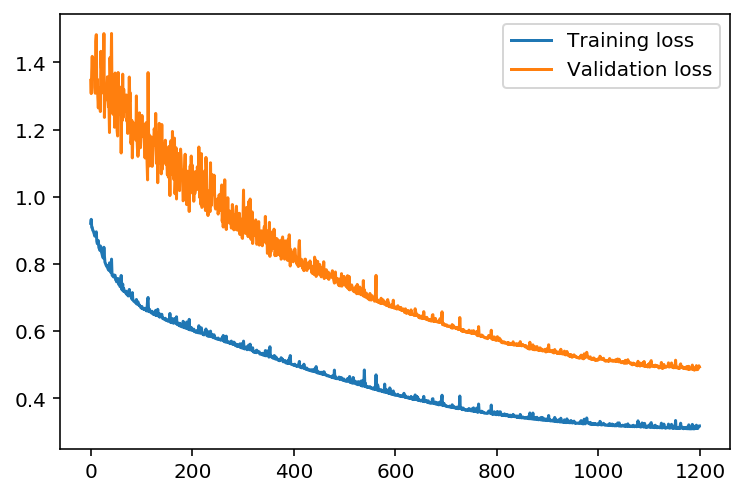

In [16]:
plt.plot(losses['train'], label='Training loss')
plt.plot(losses['validation'], label='Validation loss')
plt.legend()
_ = plt.ylim()

## 检查预测结果

使用测试数据看看网络对数据建模的效果如何。如果完全错了，请确保网络中的每步都正确实现。

/anaconda3/envs/dlnd/lib/python3.7/site-packages/ipykernel_launcher.py:10: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
  # Remove the CWD from sys.path while we load stuff.


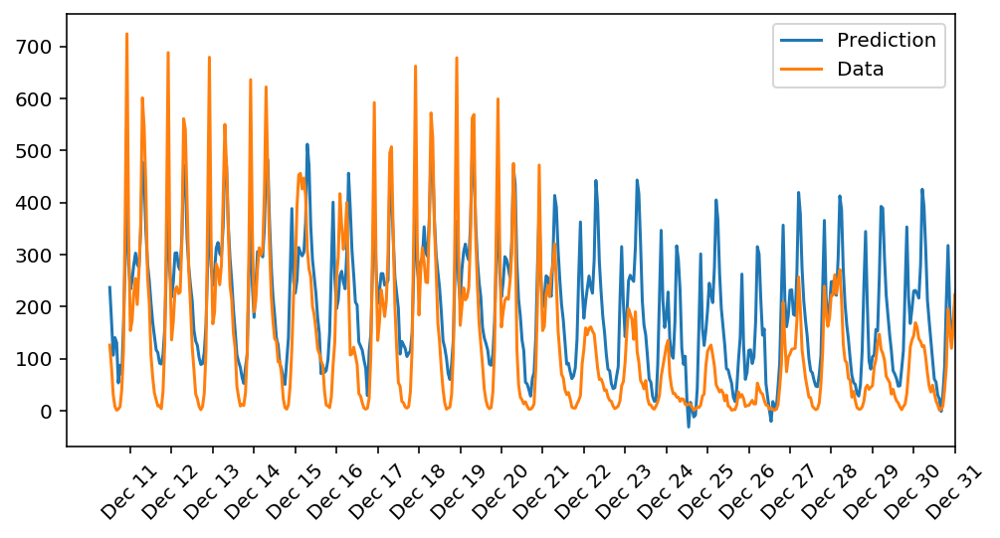

In [17]:
fig, ax = plt.subplots(figsize=(8,4))

mean, std = scaled_features['cnt']
predictions = network.run(test_features).T*std + mean
ax.plot(predictions[0], label='Prediction')
ax.plot((test_targets['cnt']*std + mean).values, label='Data')
ax.set_xlim(right=len(predictions))
ax.legend()

dates = pd.to_datetime(rides.ix[test_data.index]['dteday'])
dates = dates.apply(lambda d: d.strftime('%b %d'))
ax.set_xticks(np.arange(len(dates))[12::24])
_ = ax.set_xticklabels(dates[12::24], rotation=45)

## 可选：思考下你的结果（我们不会评估这道题的答案）

 
请针对你的结果回答以下问题。模型对数据的预测效果如何？哪里出现问题了？为何出现问题呢？

> **注意**：你可以通过双击该单元编辑文本。如果想要预览文本，请按 Control + Enter

#### 请将你的答案填写在下方

对一些尖峰的部分无法做到较好的回归结果，若拟合了尖峰则会有过度拟合的现象